In [ ]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [ ]:
pip install keras==2.12.0

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 11.6 MB/s eta 0:00:00
  Attempting uninstall: keras
    Found existing installation: keras 2.15.0
    Uninstalling keras-2.15.0:
      Successfully uninstalled keras-2.15.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow 2.15.0 requires keras<2.16,>=2.15.0, but you have keras 2.12.0 which is incompatible.


In [ ]:
import numpy as np
import pandas as pd
import re
import nltk
from nltk.corpus import stopwords
from nltk.stem.porter import PorterStemmer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
from nltk.stem.porter import PorterStemmer
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report

In [ ]:
df = pd.read_csv("/content/drive/MyDrive/Data/fake-news/train.csv", delimiter=',')

In [ ]:
df.head()

,id,title,author,text,label
0,0,House Dem Aide: We Didn’t Even See Comey’s Let...,Darrell Lucus,House Dem Aide: We Didn’t Even See Comey’s Let...,1
1,1,"FLYNN: Hillary Clinton, Big Woman on Campus - ...",Daniel J. Flynn,Ever get the feeling your life circles the rou...,0
2,2,Why the Truth Might Get You Fired,Consortiumnews.com,"Why the Truth Might Get You Fired October 29, ...",1
3,3,15 Civilians Killed In Single US Airstrike Hav...,Jessica Purkiss,Videos 15 Civilians Killed In Single US Airstr...,1
4,4,Iranian woman jailed for fictional unpublished...,Howard Portnoy,Print \nAn Iranian woman has been sentenced to...,1


In [ ]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

In [ ]:
import nltk
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


True

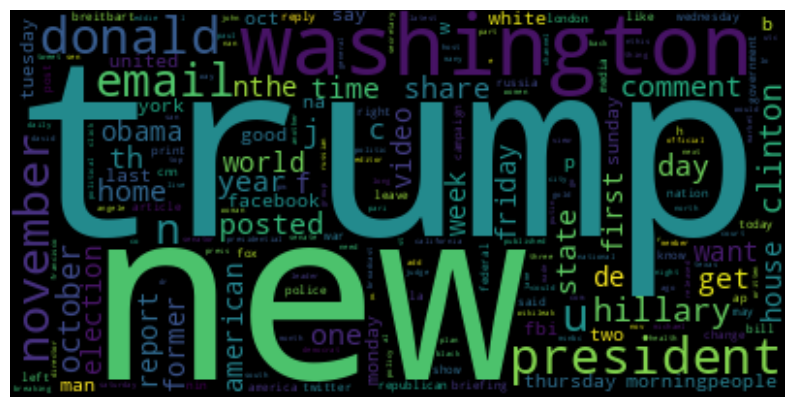

In [ ]:
from nltk.corpus import stopwords
from wordcloud import WordCloud
import re
import matplotlib.pyplot as plt

def clean_text(s):
    try:
        s = str(s)  # Convert to string
        s = re.sub(r'http\S+', '', s)
        s = re.sub('(RT|via)((?:\\b\\W*@\\w+)+)', ' ', s)
        s = re.sub(r'@\S+', '', s)
        s = re.sub('&amp', ' ', s)
        return s
    except Exception as e:
        print(f"An error occurred: {e}")
        return ""

# Assuming df is your DataFrame, make sure to replace it with the actual variable name if it's different
df['clean_text'] = df['text'].apply(clean_text)

text = df['clean_text'].to_string().lower()
wordcloud = WordCloud(
    collocations=False,
    relative_scaling=0.5,
    stopwords=set(stopwords.words('english'))).generate(text)

plt.figure(figsize=(10, 10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [ ]:
X = df['clean_text']
y = df['label']
y.value_counts()

1    10413
0    10387
Name: label, dtype: int64

In [ ]:
seed = 101 # fix random seed for reproducibility
np.random.seed(seed)
vocab_size = 10000  # Max number of different word, i.e. model input dimension
maxlen = 100

In [ ]:
# Split Train Test sets
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                    test_size=0.2,
                                                    stratify=y,
                                                    random_state=seed)
print(X_train.shape, X_test.shape, y_train.shape, y_test.shape)

(16640,) (4160,) (16640,) (4160,)


In [ ]:
from keras.preprocessing.text import Tokenizer
from keras.utils import pad_sequences
#from keras.preprocessing.sequence import pad_sequences
from sklearn.pipeline import TransformerMixin
from sklearn.base import BaseEstimator

class TextsToSequences(Tokenizer, BaseEstimator, TransformerMixin):
    """ Sklearn transformer to convert texts to indices list
    (e.g. [["the cute cat"], ["the dog"]] -> [[1, 2, 3], [1, 4]])"""
    def __init__(self,  **kwargs):
        super().__init__(**kwargs)

    def fit(self, texts, y=None):
        self.fit_on_texts(texts)
        return self

    def transform(self, texts, y=None):
        return np.array(self.texts_to_sequences(texts))

sequencer = TextsToSequences(num_words=vocab_size)

In [ ]:
class Padder(BaseEstimator, TransformerMixin):
    """ Pad and crop uneven lists to the same length.
    Only the end of lists longernthan the maxlen attribute are
    kept, and lists shorter than maxlen are left-padded with zeros

    Attributes
    ----------
    maxlen: int
        sizes of sequences after padding
    max_index: int
        maximum index known by the Padder, if a higher index is met during
        transform it is transformed to a 0
    """
    def __init__(self, maxlen=500):
        self.maxlen = maxlen
        self.max_index = None

    def fit(self, X, y=None):
        self.max_index = pad_sequences(X, maxlen=self.maxlen).max()
        return self

    def transform(self, X, y=None):
        X = pad_sequences(X, maxlen=self.maxlen)
        X[X > self.max_index] = 0
        return X

padder = Padder(maxlen)

In [ ]:
from keras.models import Sequential
from keras.layers import Dense, Embedding, LSTM, Bidirectional
from keras.wrappers.scikit_learn import KerasClassifier
from sklearn.pipeline import make_pipeline

batch_size = 128
max_features = vocab_size + 1

import tensorflow as tf
tf.random.set_seed(seed)

def create_model(max_features):
    """ Model creation function: returns a compiled LSTM"""
    model = Sequential()
    model.add(Embedding(max_features, 128))
    model.add(Bidirectional(LSTM(128, dropout=0.2, recurrent_dropout=0.2)))
    model.add(Dense(2, activation='softmax'))
    model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
    return model

In [ ]:
%%time
# Use Keras Scikit-learn wrapper to instantiate a LSTM with all methods
# required by Scikit-learn for the last step of a Pipeline
bi_lstm = KerasClassifier(build_fn=create_model, epochs=3, batch_size=batch_size,
                               max_features=max_features, verbose=1)

# Build the Scikit-learn pipeline
pipeline = make_pipeline(sequencer, padder, bi_lstm)

pipeline.fit(X_train, y_train);

<timed exec>:3: DeprecationWarning: KerasClassifier is deprecated, use Sci-Keras (https://github.com/adriangb/scikeras) instead. See https://www.adriangb.com/scikeras/stable/migration.html for help migrating.
<ipython-input-12-5deaf96a6218>:18: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return np.array(self.texts_to_sequences(texts))


Epoch 1/3
130/130 [==============================] - 66s 455ms/step - loss: 0.3348 - accuracy: 0.8576
Epoch 2/3
130/130 [==============================] - 53s 412ms/step - loss: 0.1232 - accuracy: 0.9591
Epoch 3/3
130/130 [==============================] - 50s 385ms/step - loss: 0.0550 - accuracy: 0.9831
CPU times: user 3min 39s, sys: 8.69 s, total: 3min 47s
Wall time: 3min 37s


Pipeline(steps=[('textstosequences', TextsToSequences()),
                ('padder', Padder(maxlen=100)),
                ('kerasclassifier',
                 <keras.wrappers.scikit_learn.KerasClassifier object at 0x7d3e521cf7f0>)])

In [ ]:
print('Computing predictions on test set...')

y_preds = pipeline.predict(X_test)

Computing predictions on test set...


<ipython-input-12-5deaf96a6218>:18: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return np.array(self.texts_to_sequences(texts))


130/130 [==============================] - 9s 68ms/step


In [ ]:
from sklearn.metrics import accuracy_score,confusion_matrix,classification_report
def model_evaluate():

    print('Test Accuracy:\t{:0.1f}%'.format(accuracy_score(y_test,y_preds)*100))

    #classification report
    print('\n')
    print(classification_report(y_test, y_preds))

    #confusion matrix
    confmat = confusion_matrix(y_test, y_preds)

    fig, ax = plt.subplots(figsize=(4, 4))
    ax.matshow(confmat, cmap=plt.cm.Blues, alpha=0.3)
    for i in range(confmat.shape[0]):
        for j in range(confmat.shape[1]):
            ax.text(x=j, y=i, s=confmat[i, j], va='center', ha='center')
    plt.xlabel('Predicted label')
    plt.ylabel('True label')
    plt.tight_layout()

Test Accuracy:	92.0%


              precision    recall  f1-score   support

           0       0.92      0.92      0.92      2077
           1       0.92      0.92      0.92      2083

    accuracy                           0.92      4160
   macro avg       0.92      0.92      0.92      4160
weighted avg       0.92      0.92      0.92      4160



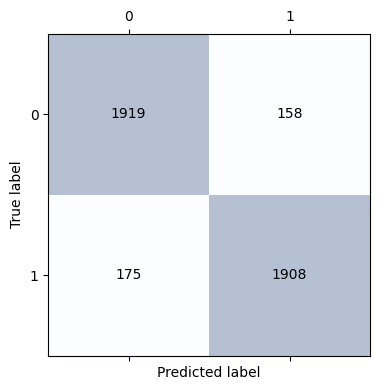

In [ ]:
model_evaluate()

In [ ]:
pip install lime -q

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 5.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done


In [ ]:
X_test[8]

'Donald J. Trump is scheduled to make a highly anticipated visit to an   church in Detroit on Saturday, the first such visit of his campaign. There, he will participate in a    session conducted by Bishop Wayne T. Jackson of the church, Great Faith Ministries International. Given the importance of the visit, the Trump team went so far as to script Mr. Trump’s answers to Bishop Jackson’s questions, which were submitted in advance. After this article was published on Thursday night, a campaign official said that Mr. Trump would also speak to the church’s congregation and then tour some neighborhoods with Ben Carson, a former presidential candidate and Detroit native. Below are excerpts from a draft of the script that was obtained by The New York Times. _____ Mr. Trump there is racial divide in our country and it is evident that the tension is boiling over. Case and point Reverend Pinckney in South Carolina was gunned down when a white young man came into their Bible Study and slaughtered

In [ ]:
y_test[8]

0

In [ ]:
class_names = ['Fake','Real']

# Define a predictor function
def predictor(texts):
    return pipeline.predict_proba(texts).round(4)

from lime.lime_text import LimeTextExplainer

# Sample text for explanation
#text = "In these trying times, Jackie Mason is the Voice of Reason. [In this week’s exclusive clip for Breitbart News, Jackie discusses the looming threat of North Korea, and explains how President Donald Trump could win the support of the Hollywood left if the U. S. needs to strike first.  “If he decides to bomb them, the whole country will be behind him, because everybody will realize he had no choice and that was the only thing to do,” Jackie says. “Except the Hollywood left. They’ll get nauseous. ” “[Trump] could win the left over, they’ll fall in love with him in a minute. If he bombed them for a better reason,” Jackie explains. “Like if they have no transgender toilets. ” Jackie also says it’s no surprise that Hollywood celebrities didn’t support Trump’s strike on a Syrian airfield this month. “They were infuriated,” he says. “Because it might only save lives. That doesn’t mean anything to them. If it only saved the environment, or climate change! They’d be the happiest people in the world. ” Still, Jackie says he’s got nothing against Hollywood celebs. They’ve got a tough life in this country. Watch Jackie’s latest clip above.   Follow Daniel Nussbaum on Twitter: "
#text="In a temporary win for political correctness the Cleveland Indians and parent company, Rogers Communications, lost an interim decision to throw out a discrimination claim alleging that the team’s mascot “Chief Wahoo” and their logo are offensive and discriminatory. [Douglas Cardinal, a Canadian architect who designed the Smithsonian’s National Museum of the American Indian and is a member of the Blackfoot tribe, filed suit in October that using the Cleveland team name “Indians” and the “Chief Wahoo” logo and mascot during games at the Toronto Blue Jays Rogers Centre violates discrimination laws under the Ontario Human Rights Code.   Cardinal’s objective is to ban the Cleveland Indians from donning their team name or logos at MLB games played in Toronto. “As an Indigenous person, I am encouraged that the Ontario Human Rights Tribunal has accepted jurisdiction over my complaint and agrees that it can proceed to a hearing,” said Cardinal in an official statement.  “Unfortunately, the consciousness of genocide and apartheid continues to be fostered by the insensitive use of demeaning and degrading symbols, mocking indigenous peoples,” Cardinal added. “This must cease in order for reconciliation to have any meaning and substance. ” On May 23, according to a document filed at canlii. com, Tribunal adjudicator   Pickel ruled that Cardinal had standing to bring suit against the Indians and Rogers. “If the applicant was either not indigenous, not a baseball fan, and not otherwise interested in attending games at the Rogers Centre, my finding on the issue of standing would have been different,” she wrote. “In my view, the applicant has asserted a sufficient personal interest to have standing to bring this application. ”  You can read Pickel’s  full ruling here. If Cardinal should win, the team would have to remove the name “Indians” and the Wahoo imagery from their uniforms when playing games in Canada.  Bill Baer at NBC Sports reports that MLB fans are the oldest of all sports fans. When they die off, younger fans will be   with Cardinal and the notion that such mascots and imagery are racist. “MLB will have trouble courting them with racist iconography,” he writes.  “Even if the humanity argument doesn’t persuade one —  which it should, full stop —  the business angle should be convincing enough to anyone involved in fighting this battle to preserve Chief Wahoo that it’s a lost cause. ”"

text="Donald J. Trump is scheduled to make a highly anticipated visit to an   church in Detroit on Saturday, the first such visit of his campaign. There, he will participate in a    session conducted by Bishop Wayne T. Jackson of the church, Great Faith Ministries International. Given the importance of the visit, the Trump team went so far as to script Mr. Trump’s answers to Bishop Jackson’s questions, which were submitted in advance. After this article was published on Thursday night, a campaign official said that Mr. Trump would also speak to the church’s congregation and then tour some neighborhoods with Ben Carson, a former presidential candidate and Detroit native. Below are excerpts from a draft of the script that was obtained by The New York Times. _____ Mr. Trump there is racial divide in our country and it is evident that the tension is boiling over. Case and point Reverend Pinckney in South Carolina was gunned down when a white young man came into their Bible Study and slaughtered the Reverend and eight other individuals because he wanted to start a race war. What would your administration do to bring down the racial tension that is in our Country? In the Bible Jesus said that a house divided cannot stand. Our best hope for erasing racial tensions in America is to work toward a   society. In business, we hire, retain and award based on merit. In society, however, we have divisions that can only be eliminated if we have equal opportunity and then equal access to programs and institutions that will lift all people in the country. We have to reform our tax system so that we can spur economic growth for the long haul. We have to have stronger enforcement of immigration laws. We have to renegotiate our trade deals so that we can bring advantage back to the American workforce. But perhaps most important is that we must provide equal opportunity for a quality education for all Americans. The higher the educational attainment, the greater the likelihood one can climb the economic ladder. We must bring school choice programs to our cities and we must get rid of Common Core. We must make sure that access, affordability and accountability are brought into our higher education system. Without a focus on educational outcomes for every American, we will perpetuate the permanent underclass that progressive policies have sustained. Republicans like me need to have the courage to speak the truth about where we are and what has to be done. We have to have the courage to go into communities and work with everyone there to make sure that our schools are good and that our children have access to the whatever educational situation they may need. This is not something one person can do, but it is something that we can do together. _____ Mr. Trump there is a perception that your administration is racist. With many of the African American voters their belief is that the Republican Party as a whole does not cater to African American needs. In 2008 and 2012 we had two Republican Candidates John McCain and Mitt Romney and neither one of them came to Detroit, or any urban area that I can remember to even address the concerns of our community. First I would like to commend you for coming to our community as a Republican Candidate. Second I need to know how would you change that perception in our community? The proof, as they say, will be in the pudding. Coming into a community is meaningless unless we can offer an alternative to the horrible progressive agenda that has perpetuated a permanent underclass in America. We need to be true to our word and offer all Americans more opportunities so that each and every one of them can reach their full potential. This means economic policies that will bring jobs back to America and will raise wages for all. This means working hard to provide as many educational options as possible to our parents and children. This means cleaning up drugs and making our neighborhoods and communities safer. We need to get people off welfare and back to work. We need to make sure that anyone who qualifies can go into a bank, get a loan and then start a business. We need to reduce regulations and expand options for people who want to be independent of government. We need to make sure that people can worship how they want and where they want without worrying that some federal agency is going to threaten the religious liberties. Republicans have better options. We just need to have the courage to present them with conviction. _____ Mr. Trump what is your vision for America? And specifically Black America? If you repeal Obama care what is your plan to provide health care and medicine to those who can’t afford it, yet need it the most? As President, I must serve all Americans without regard to race, ethnicity or any other qualification. I must approach my task with the utmost wisdom and make sure that all Americans have opportunities to achieve to their potential. If we are to Make America Great Again, we must reduce, rather than highlight, issues of race in this country. I want to make race disappear as a factor in government and governance. Every individual, regardless of race or ethnicity, must have access to the full array of opportunities in America. My vision for America is that every citizen and legal resident of this nation will be able to stand side by side and be proud of the fact that they live in the greatest nation on earth. As for the Affordable Care Act, I will work to repeal the act and replace it with market driven solutions that will offer more access to healthcare at more affordable prices. Every American should be able to purchase health insurance across state lines, have health savings account that belong to them, have price transparency so they can shop for the best services at the best prices and know that they will not have to compete with those who are clogging the system simply because they are in this country illegally. We want to block grant Medicaid so that states can provide services closer to the people. We want to make sure that every American has great economic opportunity so that they can seek out their own health insurance and still be able to afford it. This approach will serve all Americans and will ensure that more Americans are covered by better insurance and healthcare options. _____ Mr. Trump I am a registered Democrat but I am an undecided voter in this election for 2016. It is not only myself but there has been a lot of Pastors and African Americans who have not made up their minds concerning who they are going to cast their vote for. The latest polls indicate that you have 1 percent of the African American vote. What can you say to undecided voters such as myself and others in the African American Community that will win our vote on November 8, 2016? And beyond winning, why is the African American vote important to you? All votes are important to me and my campaign. Your vote, your neighbor’s vote, the vote of every American is critical and I must do all I can to make sure you know that if you vote for me, you are voting for a stronger, more vibrant America. My policies offer you a clear choice. You can continue down the road of progressivism that has created a permanent underclass in this country that, unfortunately, includes far too many people of color. If you want a better America, you must break from the historical hold that Democrats have had on people of color and move to options that allow you to achieve your potential. This is all about opportunity  —   not   outcomes and promises of things to come that never materialize. The progressives have worked tirelessly to bring all Americans down to one level rather than allowing as many as possible to rise as high as possible. Education, jobs, religious liberty and protection of civil rights are the promises that I will keep, not just utter to gain favor. If you are interested in a greater America with more opportunity, liberty and prosperity, you must take a chance and walk over to my side. If you want a strong partner in this journey, you will vote for me. I will never let you down. By the way, my support is now up to 8% and climbing."
# Create a LIME Text Explainer
explainer = LimeTextExplainer(class_names=class_names)

# Explain the prediction
exp = explainer.explain_instance(text, predictor, num_features=10, num_samples=2000)
exp.show_in_notebook(text=text)





<ipython-input-12-5deaf96a6218>:18: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return np.array(self.texts_to_sequences(texts))


63/63 [==============================] - 7s 96ms/step


In [ ]:
from scipy.stats import kendalltau

In [ ]:
actual_ranks = predictor(text)

<ipython-input-12-5deaf96a6218>:18: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return np.array(self.texts_to_sequences(texts))


256/256 [==============================] - 30s 117ms/step


In [ ]:
-np.sort(-actual_ranks[:,0])[:10]

array([0.1178, 0.0778, 0.0778, 0.0778, 0.0778, 0.0778, 0.0778, 0.0778,
       0.0778, 0.0778], dtype=float32)

In [ ]:
lime_ranks = [i[1] for i in exp.as_list()]
lime_ranks

[0.16904355985467023,
 -0.0868827400141082,
 0.04908993449438774,
 -0.047048582337433496,
 0.03631289031929246,
 0.03623528204421632,
 -0.034434332565090826,
 0.03391721384862084,
 0.0338916503240993,
 0.03199661988084568]

In [ ]:
# Calculate Kendall Tau correlation between LIME and actual predictions
lime_ranks = [i[1] for i in exp.as_list()]
actual_ranks = predictor(text)
actual_ranks_top10 = -np.sort(-actual_ranks[:,0])[:10]
kendall_tau, _ = kendalltau(lime_ranks, actual_ranks_top10)

# Print Kendall Tau correlation
print(f'\nKendall Tau Correlation: {kendall_tau}')

<ipython-input-12-5deaf96a6218>:18: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return np.array(self.texts_to_sequences(texts))


256/256 [==============================] - 22s 86ms/step

Kendall Tau Correlation: 0.4472135954999579


In [ ]:
class_names = ['Real','Fake']

# Define a predictor function
def predictor(texts):
    return pipeline.predict_proba(texts).round(4)

from lime.lime_text import LimeTextExplainer


text="A rendering of the Trump Tower in Makati City, Philippines MAKATI CITY, Philippines ( The Adobo Chronicles) – When completed by the end of 2016, the Trump Tower in the Philippines will be among the country’s tallest buildings . But the Trump name may disappear from this upscale residential building. Launched in 2012, Trump Tower is a joint venture between Century Properties and the Trump Organization. It will be managed by Century Properties Management Inc. To rise at 250 meters above ground, the 56-story building is designed by award-winning international architectural firm Broadway Malyan. “It’s really just an iconic, modern building, very tall, very chic, something that really symbolizes everything that a Trump project means,” said Eric Trump, son of Donald, and executive vice president of development and acquisition. It is located at the corner of Kalayaan Avenue and Salamanca Street in Makati City"
#t of his campaign. There, he will participate in a    session conducted by Bishop Wayne T. Jackson of the church, Great Faith Ministries International. Given the importance of the visit, the Trump team went so far as to script Mr. Trump’s answers to Bishop Jackson’s questions, which were submitted in advance. After this article was published on Thursday night, a campaign official said that Mr. Trump would also speak to the church’s congregation and then tour some neighborhoods with Ben Carson, a former presidential candidate and Detroit native. Below are excerpts from a draft of the script that was obtained by The New York Times. _____ Mr. Trump there is racial divide in our country and it is evident that the tension is boiling over. Case and point Reverend Pinckney in South Carolina was gunned down when a white young man came into their Bible Study and slaughtered the Reverend and eight other individuals because he wanted to start a race war. What would your administration do to bring down the racial tension that is in our Country? In the Bible Jesus said that a house divided cannot stand. Our best hope for erasing racial tensions in America is to work toward a   society. In business, we hire, retain and award based on merit. In society, however, we have divisions that can only be eliminated if we have equal opportunity and then equal access to programs and institutions that will lift all people in the country. We have to reform our tax system so that we can spur economic growth for the long haul. We have to have stronger enforcement of immigration laws. We have to renegotiate our trade deals so that we can bring advantage back to the American workforce. But perhaps most important is that we must provide equal opportunity for a quality education for all Americans. The higher the educational attainment, the greater the likelihood one can climb the economic ladder. We must bring school choice programs to our cities and we must get rid of Common Core. We must make sure that access, affordability and accountability are brought into our higher education system. Without a focus on educational outcomes for every American, we will perpetuate the permanent underclass that progressive policies have sustained. Republicans like me need to have the courage to speak the truth about where we are and what has to be done. We have to have the courage to go into communities and work with everyone there to make sure that our schools are good and that our children have access to the whatever educational situation they may need. This is not something one person can do, but it is something that we can do together. _____ Mr. Trump there is a perception that your administration is racist. With many of the African American voters their belief is that the Republican Party as a whole does not cater to African American needs. In 2008 and 2012 we had two Republican Candidates John McCain and Mitt Romney and neither one of them came to Detroit, or any urban area that I can remember to even address the concerns of our community. First I would like to commend you for coming to our community as a Republican Candidate. Second I need to know how would you change that perception in our community? The proof, as they say, will be in the pudding. Coming into a community is meaningless unless we can offer an alternative to the horrible progressive agenda that has perpetuated a permanent underclass in America. We need to be true to our word and offer all Americans more opportunities so that each and every one of them can reach their full potential. This means economic policies that will bring jobs back to America and will raise wages for all. This means working hard to provide as many educational options as possible to our parents and children. This means cleaning up drugs and making our neighborhoods and communities safer. We need to get people off welfare and back to work. We need to make sure that anyone who qualifies can go into a bank, get a loan and then start a business. We need to reduce regulations and expand options for people who want to be independent of government. We need to make sure that people can worship how they want and where they want without worrying that some federal agency is going to threaten the religious liberties. Republicans have better options. We just need to have the courage to present them with conviction. _____ Mr. Trump what is your vision for America? And specifically Black America? If you repeal Obama care what is your plan to provide health care and medicine to those who can’t afford it, yet need it the most? As President, I must serve all Americans without regard to race, ethnicity or any other qualification. I must approach my task with the utmost wisdom and make sure that all Americans have opportunities to achieve to their potential. If we are to Make America Great Again, we must reduce, rather than highlight, issues of race in this country. I want to make race disappear as a factor in government and governance. Every individual, regardless of race or ethnicity, must have access to the full array of opportunities in America. My vision for America is that every citizen and legal resident of this nation will be able to stand side by side and be proud of the fact that they live in the greatest nation on earth. As for the Affordable Care Act, I will work to repeal the act and replace it with market driven solutions that will offer more access to healthcare at more affordable prices. Every American should be able to purchase health insurance across state lines, have health savings account that belong to them, have price transparency so they can shop for the best services at the best prices and know that they will not have to compete with those who are clogging the system simply because they are in this country illegally. We want to block grant Medicaid so that states can provide services closer to the people. We want to make sure that every American has great economic opportunity so that they can seek out their own health insurance and still be able to afford it. This approach will serve all Americans and will ensure that more Americans are covered by better insurance and healthcare options. _____ Mr. Trump I am a registered Democrat but I am an undecided voter in this election for 2016. It is not only myself but there has been a lot of Pastors and African Americans who have not made up their minds concerning who they are going to cast their vote for. The latest polls indicate that you have 1 percent of the African American vote. What can you say to undecided voters such as myself and others in the African American Community that will win our vote on November 8, 2016? And beyond winning, why is the African American vote important to you? All votes are important to me and my campaign. Your vote, your neighbor’s vote, the vote of every American is critical and I must do all I can to make sure you know that if you vote for me, you are voting for a stronger, more vibrant America. My policies offer you a clear choice. You can continue down the road of progressivism that has created a permanent underclass in this country that, unfortunately, includes far too many people of color. If you want a better America, you must break from the historical hold that Democrats have had on people of color and move to options that allow you to achieve your potential. This is all about opportunity  —   not   outcomes and promises of things to come that never materialize. The progressives have worked tirelessly to bring all Americans down to one level rather than allowing as many as possible to rise as high as possible. Education, jobs, religious liberty and protection of civil rights are the promises that I will keep, not just utter to gain favor. If you are interested in a greater America with more opportunity, liberty and prosperity, you must take a chance and walk over to my side. If you want a strong partner in this journey, you will vote for me. I will never let you down. By the way, my support is now up to 8% and climbing."
# Create a LIME Text Explainer
explainer = LimeTextExplainer(class_names=class_names)

# Explain the prediction
exp = explainer.explain_instance(text, predictor, num_features=10, num_samples=2000, top_labels=1)

# Show the explanation in a notebook
exp.show_in_notebook(text=text)


 2/63 [..............................] - ETA: 3s

<ipython-input-12-5deaf96a6218>:18: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return np.array(self.texts_to_sequences(texts))


63/63 [==============================] - 4s 68ms/step


In [ ]:
# Calculate Kendall Tau correlation between LIME and actual predictions
lime_ranks = [i[1] for i in exp.as_list()]
actual_ranks = predictor(text)
actual_ranks_top10 = -np.sort(-actual_ranks[:,0])[:10]
kendall_tau, _ = kendalltau(lime_ranks, actual_ranks_top10)

# Print Kendall Tau correlation
print(f'\nKendall Tau Correlation: {kendall_tau}')

 2/29 [=>............................] - ETA: 1s

<ipython-input-12-5deaf96a6218>:18: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return np.array(self.texts_to_sequences(texts))


29/29 [==============================] - 2s 57ms/step

Kendall Tau Correlation: -0.8027729719194864


In [ ]:
actual_ranks_top10

array([0.1344, 0.0778, 0.0778, 0.0778, 0.0778, 0.07  , 0.07  , 0.07  ,
       0.07  , 0.07  ], dtype=float32)

In [ ]:
lime_ranks

[-0.037840349443034875,
 -0.03435104869803449,
 -0.031233982718627193,
 -0.03037302498895778,
 -0.029560094677198737,
 -0.022732448352973715,
 0.012778069264509874,
 0.011388411956314924,
 0.006880985504815437,
 0.005679416180143595]

In [ ]:
# We choose a sample from test set
idx = 687

test_text = np.array(X_test)
test_class = np.array(y_test)
text_sample = test_text[idx]
class_names = [ 'Fake', 'Real']
print(text_sample)
print('Probability =', pipeline.predict_proba([text_sample]).round(2))
print('True class: %s' % class_names[test_class[idx]])

Drivers across the country are racing to their local Department of Motor Vehicles offices to claim “covfefe” vanity license plates just days following President Trump’s tweetwhere he meant to type “negative press coverage” and instead wrote “covfefe. ”[Drivers have already claimed their “covfefe” vanity plate in at least 21 states, including California, North Carolina, Maine, and Nebraska since Trump sent out his tweet early Wednesday morning, CNN reported.  Greg Cooper, a California attorney, was one of the first in the nation to claim his state’s “covfefe” license plate. His daughter, Tayla, posted a photo of him with the plate design to Twitter, which received over 97, 000 likes and has been retweeted over 20, 000 times. Cooper, who was with family when he saw Trump’s tweet and thought it would be funny to buy a “covfefe” vanity plate, said he has not decided whether he will attach the license plate to his car when it arrives in 12 weeks. Evan Milton, 26, of Nebraska, claimed his st

In [ ]:
from lime.lime_text import LimeTextExplainer
explainer = LimeTextExplainer(class_names=class_names)
exp = explainer.explain_instance(text_sample, pipeline.predict_proba, num_features=10, top_labels=0)
exp.show_in_notebook(text=text_sample)

  2/157 [..............................] - ETA: 8s 

<ipython-input-12-5deaf96a6218>:18: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return np.array(self.texts_to_sequences(texts))


157/157 [==============================] - 14s 92ms/step


In [ ]:
# Calculate Kendall Tau correlation between LIME and actual predictions
lime_ranks = [i[1] for i in exp.as_list()]
actual_ranks = predictor(text)
actual_ranks_top10 = -np.sort(-actual_ranks[:,0])[:10]
kendall_tau, _ = kendalltau(lime_ranks, actual_ranks_top10)

# Print Kendall Tau correlation
print(f'\nKendall Tau Correlation: {kendall_tau}')

  1/256 [..............................] - ETA: 28s

<ipython-input-12-5deaf96a6218>:18: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return np.array(self.texts_to_sequences(texts))


256/256 [==============================] - 16s 62ms/step

Kendall Tau Correlation: -0.4472135954999579


In [ ]:
# We choose a sample from test set
idx = 1441

test_text = np.array(X_test)
test_class = np.array(y_test)
text_sample = test_text[idx]
class_names = [ 'Real', 'Fake']
print(text_sample)
print('Probability =', pipeline.predict_proba([text_sample]).round(2))
print('True class: %s' % class_names[test_class[idx]])


Notify me of follow-up comments by email. Notify me of new posts by email. PLEASE DONATE TO KEEP BARE NAKED ISLAM UP AND RUNNING. Choose DONATE for one-time donation or SUBSCRIBE for monthly donations Payment Options GET ALL NEW BNI POSTS/LINKS ON TWITTER Subscribe to Blog via Email 
Enter your email address to subscribe to this blog and receive notifications of new posts by email. Email Address CONTACT: barenakedislam Top Posts
1/1 [==============================] - 0s 92ms/step
Probability = [[0. 1.]]
True class: Fake


In [ ]:
X_test[5]

'In these trying times, Jackie Mason is the Voice of Reason. [In this week’s exclusive clip for Breitbart News, Jackie discusses the looming threat of North Korea, and explains how President Donald Trump could win the support of the Hollywood left if the U. S. needs to strike first.  “If he decides to bomb them, the whole country will be behind him, because everybody will realize he had no choice and that was the only thing to do,” Jackie says. “Except the Hollywood left. They’ll get nauseous. ” “[Trump] could win the left over, they’ll fall in love with him in a minute. If he bombed them for a better reason,” Jackie explains. “Like if they have no transgender toilets. ” Jackie also says it’s no surprise that Hollywood celebrities didn’t support Trump’s strike on a Syrian airfield this month. “They were infuriated,” he says. “Because it might only save lives. That doesn’t mean anything to them. If it only saved the environment, or climate change! They’d be the happiest people in the wo

In [ ]:
# We choose a sample from test set
idx = 1000
test_text = np.array(X_test)
test_class = np.array(y_test)
text_sample = test_text[idx]
class_names = [ 'Real', 'Fake']
print(text_sample)
print('Probability =', pipeline.predict_proba([text_sample]).round(2))
print('True class: %s' % class_names[test_class[idx]])

Better than Bob Dylan, says Gary North . 12:52 am on October 28, 2016
1/1 [==============================] - 0s 21ms/step
Probability = [[0. 1.]]
True class: Fake


In [ ]:
from lime.lime_text import LimeTextExplainer
explainer = LimeTextExplainer(class_names=class_names)
exp = explainer.explain_instance(text_sample, pipeline.predict_proba, num_features=6, top_labels=1)
exp.show_in_notebook(text=text_sample)

  8/157 [>.............................] - ETA: 2s

<ipython-input-14-3e697ae8eb88>:16: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return np.array(self.tokenizer.texts_to_sequences(texts))


157/157 [==============================] - 3s 18ms/step


In [ ]:
# We choose a sample from test set
idx = 1400
test_text = np.array(X_test)
test_class = np.array(y_test)
text_sample = test_text[idx]
class_names = [ 'Real', 'Fake']
print(text_sample)
print('Probability =', pipeline.predict_proba([text_sample]).round(2))
print('True class: %s' % class_names[test_class[idx]])

Written by Alex Eammons   When Donald Trump becomes commander in chief in January, he will take on presidential powers that have never been more expansive and unchecked.He’ll control an unaccountable drone program, and the prison at Guantanamo Bay. His FBI, including a network of 15,000 paid informants, already has a record of spying on mosques and activists , and his NSA’s surveillance empire is ubiquitous and governed by arcane rules, most of which remain secret. He will inherit bombing campaigns in seven Muslim countries, the de facto ability to declare war unilaterally, and a massive nuclear arsenal — much of which is on hair-trigger alert .Caught off guard by Hillary Clinton’s election defeat, Democrats who defended these powers under President Obama may suddenly be having second thoughts as the White House gets handed over to a man they described — with good reason — as “unhinged, ” and “dangerously unfit.” In the years after the 9/11 terror attacks, Vice President Dick Cheney an

In [ ]:
from lime.lime_text import LimeTextExplainer
explainer = LimeTextExplainer(class_names=class_names)
exp = explainer.explain_instance(text_sample, pipeline.predict_proba, num_features=6, top_labels=1)
exp.show_in_notebook(text=text_sample)

  4/157 [..............................] - ETA: 2s

<ipython-input-14-3e697ae8eb88>:16: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return np.array(self.tokenizer.texts_to_sequences(texts))


157/157 [==============================] - 3s 19ms/step


Ok...now to interpret! You can see all the words highlighted in orange which contributes to the positive classification. The decimal values show the proportion of how much that word contributes to the class label.

The word 'Related' is a major reason for the positive classification, let's see what happens when we remove it!

In [ ]:
text_sample2 = re.sub('Related', ' ', text_sample)
print(text_sample2)

Written by Alex Eammons   When Donald Trump becomes commander in chief in January, he will take on presidential powers that have never been more expansive and unchecked.He’ll control an unaccountable drone program, and the prison at Guantanamo Bay. His FBI, including a network of 15,000 paid informants, already has a record of spying on mosques and activists , and his NSA’s surveillance empire is ubiquitous and governed by arcane rules, most of which remain secret. He will inherit bombing campaigns in seven Muslim countries, the de facto ability to declare war unilaterally, and a massive nuclear arsenal — much of which is on hair-trigger alert .Caught off guard by Hillary Clinton’s election defeat, Democrats who defended these powers under President Obama may suddenly be having second thoughts as the White House gets handed over to a man they described — with good reason — as “unhinged, ” and “dangerously unfit.” In the years after the 9/11 terror attacks, Vice President Dick Cheney an

In [ ]:
print('Probability =', pipeline.predict_proba([text_sample2]).round(3))

1/1 [==============================] - 0s 61ms/step
Probability = [[0.014 0.986]]


when you remove 'Related', the LSTM model class probabilities have indeed changed!


In [ ]:
X_test[32]

'LONDON  —   With their giddy celebrations of “independence day” having given way to political and economic turmoil, one thing has become especially clear about the former London mayor Boris Johnson and other leaders of the successful campaign to vote Britain out of the European Union: They had no plan for what comes next. In the days since Britain voted to leave the bloc, the movement’s leaders have often appeared as if they had not expected to win and were not prepared to cope with the consequences. Faced with the scope of the decision, they have been busy walking back promises they made during the campaign and scaling back expectations. They have failed to show a united front or to answer basic questions. Their faltering performance has added to the sense of political chaos in Britain and, arguably, to the turmoil in the financial markets. And it has undercut their credibility and authority as Mr. Johnson prepares his bid to become prime minister and lead Britain into a new relation

In [ ]:
class_names = ['Reliable','Unreliable']

# Define a predictor function
def predictor(texts):
    return pipeline.predict_proba(texts).round(2)

from lime.lime_text import LimeTextExplainer


text="LONDON  —   With their giddy celebrations of “independence day” having given way to political and economic turmoil, one thing has become especially clear about the former London mayor Boris Johnson and other leaders of the successful campaign to vote Britain out of the European Union: They had no plan for what comes next. In the days since Britain voted to leave the bloc, the movement’s leaders have often appeared as if they had not expected to win and were not prepared to cope with the consequences. Faced with the scope of the decision, they have been busy walking back promises they made during the campaign and scaling back expectations. They have failed to show a united front or to answer basic questions. Their faltering performance has added to the sense of political chaos in Britain and, arguably, to the turmoil in the financial markets. And it has undercut their credibility and authority as Mr. Johnson prepares his bid to become prime minister and lead Britain into a new relationship with the Continent. The stakes are high for Mr. Johnson in particular, as he tries to build an impression as a capable leader amid the chaos that followed the vote in favor of a British exit, or “Brexit. ” But the mixed signals coming from him and other proponents of leaving the European Union have left their intentions unclear on such basic issues as when and how they will seek to negotiate a withdrawal, and what kind of new arrangement they want. To the degree that they have signaled a direction, it has often been substantially different from what they promised during the campaign. On issues from immigration to spending on the National Health Service, the “Leave” coalition has retreated from its more populist and apparently exaggerated claims. Many of those assertions had been promoted by the   U. K. Independence Party, or UKIP, led by Nigel Farage, and benefited the broader Leave campaign, whose most prominent figures included two senior Conservatives, Mr. Johnson and Michael Gove, the justice minister. In changing their tune, the leaders of the   Union campaign risk undermining whatever trust they had earned from the millions who voted to leave the bloc in the expectation that immigration would be cut sharply and that money now going to the European Union  —   which the Leave campaign said was 350 million pounds, or $465 million, a week  —   would be available to help finance the National Health Service. For example, one Leave advocate, Iain Duncan Smith, a former Conservative Party leader and cabinet secretary, walked away from the campaign pledge to reallocate the £350 million a week to the health service. Instead, he said, “the lion’s share” of anything left from that amount after replacing subsidies from the bloc to British farmers could be available for health services. On immigration, too, there was immediate backtracking from Mr. Johnson and Daniel Hannan, a member of the European Parliament from the Conservative Party, who told the BBC, “Frankly, if people watching think that they have voted and there is now going to be zero immigration from the E. U. they are going to be disappointed. ” Analysts say the change in tone may be necessary to begin reeling in unrealistic expectations about the changes the referendum could produce, but it also holds considerable political peril for Mr. Johnson and other Conservative Party leaders of the Leave campaign, especially with populist sentiment spreading and   groups like the U. K. Independence Party eager to build support. “There is a clear tension between what the voter wanted and what senior euroskeptic leaders want to produce,” said Matthew Goodwin, a professor of politics and international relations at the University of Kent. “If they don’t deliver radical reforms on immigration, it would be the equivalent of pouring gasoline on the populist UKIP fire that has been burning since 2010. ” In his regular column in The Daily Telegraph on Monday, Mr. Johnson tried to strike a prime ministerial tone of unity in the wake of the divisive referendum, but he emphasized continuity over change and tried to argue that immigration, clearly the primary motivation for many voters in taking a position against Europe, was somehow not a major issue. “It is said that those who voted Leave were mainly driven by anxieties about immigration,” Mr. Johnson wrote. “I do not believe that is so. ” Suggesting that he wants to keep some kind of open flow of people across the border with Europe, Mr. Johnson wrote, “British people will still be able to go and work in the E. U. to live to travel to study to buy homes and to settle down. ” Not only that, he asserted, “There will continue to be free trade, and access to the single market. ” What he described was a relationship with the European Union like that of Norway, which would allow freedom of movement and labor and would pay money to Brussels in return for access to the single market, but without having a voice in  . But Mr. Johnson rejected the Norway model during the campaign, and even if negotiations proved to lead to a slightly enhanced Norway, with some symbolic measures to restrict immigration of European Union citizens to Britain, the result would be a betrayal of those who voted Leave. And right now, Norway pays Brussels roughly per capita what Britain currently does as a full member. “The difficulty for Boris and Gove is that Brexit feels like a column gone wrong, an academic exercise suddenly turned into reality,” Paul Waugh wrote in his blog for The Huffington Post, alluding to the shared backgrounds in journalism of Mr. Johnson and Mr. Gove. “And reality, particularly where the E. U. is concerned, is a messy, complex thing. ” Mr. Johnson is clearly looking to unite the divided Conservative Party behind his own, flamboyant self and to burnish his   economic credentials. But playing down immigration, Mr. Goodwin said, could create more political trouble. “I worry for senior euroskeptic leaders, because there is a misunderstanding of the vote, and that will feed voter dissatisfaction,” he said, driving many of the voters who chose a British exit to turn away from both mainstream parties and move to the populist right. The referendum was unusual, because it pitted a government on one side, “Remain,” against a loose coalition on the other, made up of Conservatives, some Labour legislators and U. K. Independence Party supporters. The Leave side never had to hammer out an agreement on how to proceed if it won, said Tony Travers, a professor of government at the London School of Economics. “There was no coherence, because it wasn’t a political party fighting for government, but an odd coalition fighting against something, but with no consistent view of what it was fighting for,” he said. Even on the economy, the Leave side was made of   economists who believe in no tariffs at all, those who believe in trade deals and protectionists who want to shield the declining working class against globalization, Professor Travers said. “And now the government will have to be reformed as if it were representing the Leave side and yet represent both, a   government that must reflect the schism in itself,” he said. In the aftermath of the Leave campaign’s victory, the political editor for Sky News, Faisal Islam, asked a Conservative member of Parliament who supported leaving the bloc to see his camp’s plan. The legislator replied, according to Mr. Islam: “There is no plan. The Leave campaign don’t have a   plan. ” Then the legislator added, “Number 10 should have had a plan,” referring to the prime minister’s office."
explainer = LimeTextExplainer(class_names=class_names)

# Explain the prediction
exp = explainer.explain_instance(text, predictor, num_features=7, num_samples=10000)
exp.show_in_notebook(text=text)

<ipython-input-12-5deaf96a6218>:18: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return np.array(self.texts_to_sequences(texts))


313/313 [==============================] - 11s 34ms/step


In [ ]:
# We choose a sample from test set
idx = 1353
test_text = np.array(X_test)
test_class = np.array(y_test)
text_sample = test_text[idx]
class_names = [ 'Real', 'Fake']
print(text_sample)
print('Probability =', pipeline.predict_proba([text_sample]))
print('True class: %s' % class_names[test_class[idx]])

— Political Polls ( October 26, 2016 Clinton up by just 3pts., Trump helped by increased support amng indies — new  #Poll More:  pic.twitter.com/lMsIDo9naJ 
— Fox News Poll ( October 26, 2016 
At 41-28 Trump should be leading the over all poll. Over sampling is happening somewhere. 

Here’s the thing: Bernie voters and black Americans were already Democrats. (Even if she gets 100% of them (which she won’t) she’s not broadening her numbers beyond her own party . . . which is a mere 29% of the electorate.) 
Let’s recap: 29% of the country are Democrats, 29% are Republicans and 42% are Independents. See here:  
Whoever wins Independents wins the election. 
Trump is more than doubling Hillary’s position with Independents. He’s leading in the single largest voting bloc in the country . . . yet all the mainstream media propaganda polls are pretending like Hillary’s ahead. 
(Of course she isn’t. She’s been losing this entire cycle–with the media grossly oversampling Democrats and undersamplin

In [ ]:
from lime.lime_text import LimeTextExplainer
explainer = LimeTextExplainer(class_names=class_names)
exp = explainer.explain_instance(text_sample, pipeline.predict_proba, num_features=6, top_labels=1,num_samples=10000)
exp.show_in_notebook(text=text_sample)



  1/313 [..............................] - ETA: 14s

<ipython-input-12-5deaf96a6218>:18: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return np.array(self.texts_to_sequences(texts))


313/313 [==============================] - 12s 39ms/step


In [ ]:
# We choose a sample from test set
idx = 123
test_text = np.array(X_test)
test_class = np.array(y_test)
text_sample = test_text[idx]
class_names = [ 'Real', 'Fake']
print(text_sample)
print('Probability =', pipeline.predict_proba([text_sample]))
print('True class: %s' % class_names[test_class[idx]])

Officials in El Salvador held emergency meetings after seeing a sharp increase in the number of violent gang members being deported back to the country from the United States under the Trump administration. [Salvadoran authorities have held emergency meetings and proposed new legislation to monitor returning criminals and gang members that are returning to El Salvador after deportation, according to the Washington Post.  The move by Salvadoran officials comes as a direct result of the Trump administration’s crackdown on illegal immigration and efforts to deport more criminal illegal aliens from the U. S. This year the U. S. has already deported 398 gang members back to El Salvador  —   compared to only 534 for all of 2016. It is due to this rapid increase in deportations that Salvadoran officials like Héctor Antonio Rodríguez, the director of the country’s immigration agency, are worried about the impact the returning gang members will have in the country. “This clearly affects El Salv

In [ ]:
from lime.lime_text import LimeTextExplainer
explainer = LimeTextExplainer(class_names=class_names)
exp = explainer.explain_instance(text_sample, pipeline.predict_proba, num_features=6, top_labels=1,num_samples=10000)
exp.show_in_notebook(text=text_sample)


In [ ]:
class_names = ['Reliable','Unreliable']

# Define a predictor function
def predictor(texts):
    return pipeline.predict_proba(texts).round(2)

from lime.lime_text import LimeTextExplainer


text="Officials in El Salvador held emergency meetings after seeing a sharp increase in the number of violent gang members being deported back to the country from the United States under the Trump administration. [Salvadoran authorities have held emergency meetings and proposed new legislation to monitor returning criminals and gang members that are returning to El Salvador after deportation, according to the Washington Post.  The move by Salvadoran officials comes as a direct result of the Trump administration’s crackdown on illegal immigration and efforts to deport more criminal illegal aliens from the U. S. This year the U. S. has already deported 398 gang members back to El Salvador  —   compared to only 534 for all of 2016. It is due to this rapid increase in deportations that Salvadoran officials like Héctor Antonio Rodríguez, the director of the country’s immigration agency, are worried about the impact the returning gang members will have in the country. “This clearly affects El Salvador. We already have a climate of violence in the country that we are combating,” Rodríguez said. “If gang members return, of course this worries us. ” Many of the returning gang members belong to   a notoriously violent street gang that has plagued communities throughout the U. S. with horrific acts of violence. Although   started out in Salvadoran communities in Los Angeles sometime during the 1980’s, lax immigration policies and weak border security helped the gang explode in size as   originated from illegal immigrants, Breitbart Texas reported. The recent murders of four teens in New York City have put   in the national spotlight with Attorney General Jeff Sessions declaring that U. S. authorities are going after the gang. “The   motto is kill, rape, and control,” Sessions said. “I have a message to the gangs that are targeting our young people: We are targeting you. We are coming after you. ” Speaking at a rally in April, President Trump highlighted the importance of removing illegal alien   gang members from the U. S.: At the heart of my administration’s efforts to restore the rule of law has been a nationwide crackdown on criminal gangs, and that means taking the fight to the sanctuary cities that shield these dangerous criminals from removal. The last very weak administration allowed thousands and thousands of gang members to cross our borders and enter into our communities, where they wreaked havoc on our citizens. The bloodthirsty cartel known as   has infiltrated our schools, threatening innocent children. We have seen the horrible assaults and many killings all along Long Island where I grew up. We are seeing the vicious spread of transnational gangs into all 50 states and the human suffering they bring with them. I have been with the parents. It is devastation. A very respected General recently told me that   are the equivalent in their meanness to Al Qaeda. My administration will not rest until we have dismantled these violent gangs, and we are doing it rapidly, and we are sending them the hell out of our country. On Wednesday, Breitbart Texas reported that Sen. Ron Johnson ( ) Chairman of the Senate Homeland Security Committee, said recently obtained documents from a whistleblower show that the Obama administration knowingly admitted 16   gang members in 2014. Ryan Saavedra is a contributor for Breitbart Texas and can be found on Twitter at "
#text="LONDON  —   With their giddy celebrations of “independence day” having given way to political and economic turmoil, one thing has become especially clear about the former London mayor Boris Johnson and other leaders of the successful campaign to vote Britain out of the European Union: They had no plan for what comes next. In the days since Britain voted to leave the bloc, the movement’s leaders have often appeared as if they had not expected to win and were not prepared to cope with the consequences. Faced with the scope of the decision, they have been busy walking back promises they made during the campaign and scaling back expectations. They have failed to show a united front or to answer basic questions. Their faltering performance has added to the sense of political chaos in Britain and, arguably, to the turmoil in the financial markets. And it has undercut their credibility and authority as Mr. Johnson prepares his bid to become prime minister and lead Britain into a new relationship with the Continent. The stakes are high for Mr. Johnson in particular, as he tries to build an impression as a capable leader amid the chaos that followed the vote in favor of a British exit, or “Brexit. ” But the mixed signals coming from him and other proponents of leaving the European Union have left their intentions unclear on such basic issues as when and how they will seek to negotiate a withdrawal, and what kind of new arrangement they want. To the degree that they have signaled a direction, it has often been substantially different from what they promised during the campaign. On issues from immigration to spending on the National Health Service, the “Leave” coalition has retreated from its more populist and apparently exaggerated claims. Many of those assertions had been promoted by the   U. K. Independence Party, or UKIP, led by Nigel Farage, and benefited the broader Leave campaign, whose most prominent figures included two senior Conservatives, Mr. Johnson and Michael Gove, the justice minister. In changing their tune, the leaders of the   Union campaign risk undermining whatever trust they had earned from the millions who voted to leave the bloc in the expectation that immigration would be cut sharply and that money now going to the European Union  —   which the Leave campaign said was 350 million pounds, or $465 million, a week  —   would be available to help finance the National Health Service. For example, one Leave advocate, Iain Duncan Smith, a former Conservative Party leader and cabinet secretary, walked away from the campaign pledge to reallocate the £350 million a week to the health service. Instead, he said, “the lion’s share” of anything left from that amount after replacing subsidies from the bloc to British farmers could be available for health services. On immigration, too, there was immediate backtracking from Mr. Johnson and Daniel Hannan, a member of the European Parliament from the Conservative Party, who told the BBC, “Frankly, if people watching think that they have voted and there is now going to be zero immigration from the E. U. they are going to be disappointed. ” Analysts say the change in tone may be necessary to begin reeling in unrealistic expectations about the changes the referendum could produce, but it also holds considerable political peril for Mr. Johnson and other Conservative Party leaders of the Leave campaign, especially with populist sentiment spreading and   groups like the U. K. Independence Party eager to build support. “There is a clear tension between what the voter wanted and what senior euroskeptic leaders want to produce,” said Matthew Goodwin, a professor of politics and international relations at the University of Kent. “If they don’t deliver radical reforms on immigration, it would be the equivalent of pouring gasoline on the populist UKIP fire that has been burning since 2010. ” In his regular column in The Daily Telegraph on Monday, Mr. Johnson tried to strike a prime ministerial tone of unity in the wake of the divisive referendum, but he emphasized continuity over change and tried to argue that immigration, clearly the primary motivation for many voters in taking a position against Europe, was somehow not a major issue. “It is said that those who voted Leave were mainly driven by anxieties about immigration,” Mr. Johnson wrote. “I do not believe that is so. ” Suggesting that he wants to keep some kind of open flow of people across the border with Europe, Mr. Johnson wrote, “British people will still be able to go and work in the E. U. to live to travel to study to buy homes and to settle down. ” Not only that, he asserted, “There will continue to be free trade, and access to the single market. ” What he described was a relationship with the European Union like that of Norway, which would allow freedom of movement and labor and would pay money to Brussels in return for access to the single market, but without having a voice in  . But Mr. Johnson rejected the Norway model during the campaign, and even if negotiations proved to lead to a slightly enhanced Norway, with some symbolic measures to restrict immigration of European Union citizens to Britain, the result would be a betrayal of those who voted Leave. And right now, Norway pays Brussels roughly per capita what Britain currently does as a full member. “The difficulty for Boris and Gove is that Brexit feels like a column gone wrong, an academic exercise suddenly turned into reality,” Paul Waugh wrote in his blog for The Huffington Post, alluding to the shared backgrounds in journalism of Mr. Johnson and Mr. Gove. “And reality, particularly where the E. U. is concerned, is a messy, complex thing. ” Mr. Johnson is clearly looking to unite the divided Conservative Party behind his own, flamboyant self and to burnish his   economic credentials. But playing down immigration, Mr. Goodwin said, could create more political trouble. “I worry for senior euroskeptic leaders, because there is a misunderstanding of the vote, and that will feed voter dissatisfaction,” he said, driving many of the voters who chose a British exit to turn away from both mainstream parties and move to the populist right. The referendum was unusual, because it pitted a government on one side, “Remain,” against a loose coalition on the other, made up of Conservatives, some Labour legislators and U. K. Independence Party supporters. The Leave side never had to hammer out an agreement on how to proceed if it won, said Tony Travers, a professor of government at the London School of Economics. “There was no coherence, because it wasn’t a political party fighting for government, but an odd coalition fighting against something, but with no consistent view of what it was fighting for,” he said. Even on the economy, the Leave side was made of   economists who believe in no tariffs at all, those who believe in trade deals and protectionists who want to shield the declining working class against globalization, Professor Travers said. “And now the government will have to be reformed as if it were representing the Leave side and yet represent both, a   government that must reflect the schism in itself,” he said. In the aftermath of the Leave campaign’s victory, the political editor for Sky News, Faisal Islam, asked a Conservative member of Parliament who supported leaving the bloc to see his camp’s plan. The legislator replied, according to Mr. Islam: “There is no plan. The Leave campaign don’t have a   plan. ” Then the legislator added, “Number 10 should have had a plan,” referring to the prime minister’s office."
explainer = LimeTextExplainer(class_names=class_names)

# Explain the prediction
exp = explainer.explain_instance(text, predictor, num_features=7, num_samples=10000, top_labels=1)
exp.show_in_notebook(text=text)

  1/313 [..............................] - ETA: 13s

<ipython-input-12-5deaf96a6218>:18: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return np.array(self.texts_to_sequences(texts))


313/313 [==============================] - 12s 39ms/step


# We choose a sample from test set
idx = 123
test_text = np.array(X_test)
test_class = np.array(y_test)
text_sample = test_text[idx]
class_names = [ 'Real', 'Fake']
print(text_sample)
print('Probability =', pipeline.predict_proba([text_sample]))
print('True class: %s' % class_names[test_class[idx]])

In [ ]:
# We choose a sample from test set
idx = 786
test_text = np.array(X_test)
test_class = np.array(y_test)
text_sample = test_text[idx]
class_names = [ 'Real', 'Fake']
print(text_sample)
print('Probability =', pipeline.predict_proba([text_sample]))
print('True class: %s' % class_names[test_class[idx]])

The swirl of revelations and allegations about Russian involvement in the American presidential election, which has been building since the summer, can be difficult to keep straight. For example, though analysts often say that Russia “hacked the election,” this shorthand refers to something much subtler than altering the vote itself  —   just one of many points of growing confusion. What follows is a guide to what is known and is not, and to separating fact from misconception. • Russian security agencies infiltrated Democratic National Committee email servers last year and again this spring, according to American intelligence assessments and several independent security firms. The Russians also hacked a private email account belonging to John D. Podesta, the chairman of Hillary Clinton’s presidential campaign. • This summer, intermediaries linked to the Russian government passed the emails to WikiLeaks and to an anonymous WordPress blog called Guccifer 2. 0. Those outlets released the 

In [ ]:
from lime.lime_text import LimeTextExplainer
explainer = LimeTextExplainer(class_names=class_names)
exp = explainer.explain_instance(text_sample, pipeline.predict_proba, num_features=6, top_labels=1,num_samples=1000)
exp.show_in_notebook(text=text_sample)

 5/32 [===>..........................] - ETA: 0s

<ipython-input-12-5deaf96a6218>:18: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return np.array(self.texts_to_sequences(texts))


32/32 [==============================] - 1s 28ms/step


In [ ]:
class_names = ['Reliable','Unreliable']

# Define a predictor function
def predictor(texts):
    return pipeline.predict_proba(texts).round(2)

from lime.lime_text import LimeTextExplainer


text="The swirl of revelations and allegations about Russian involvement in the American presidential election, which has been building since the summer, can be difficult to keep straight. For example, though analysts often say that Russia “hacked the election,” this shorthand refers to something much subtler than altering the vote itself  —   just one of many points of growing confusion. What follows is a guide to what is known and is not, and to separating fact from misconception. • Russian security agencies infiltrated Democratic National Committee email servers last year and again this spring, according to American intelligence assessments and several independent security firms. The Russians also hacked a private email account belonging to John D. Podesta, the chairman of Hillary Clinton’s presidential campaign. • This summer, intermediaries linked to the Russian government passed the emails to WikiLeaks and to an anonymous WordPress blog called Guccifer 2. 0. Those outlets released the emails publicly, generating weeks of unfavorable coverage of Mrs. Clinton’s campaign. • Initially, many analysts believed that Russia’s goal was to sow confusion and undermine Americans’ faith in their government  —   a common Russian tactic  —   rather than to steer the election’s outcome. • However, after the election, the Central Intelligence Agency concluded that Russia had released the emails with the primary goal of bolstering Donald J. Trump’s presidential campaign. • No information has emerged suggesting that the C. I. A. believes that Russia’s involvement decided the election’s outcome. • There is no evidence that hackers, from Russia or elsewhere, tampered with the vote tallies. • Mr. Trump has said there was widespread voter fraud that favored Mrs. Clinton, and some liberal commentators have suggested that the election was hacked. Independent analysts say there is overwhelming evidence against both claims. • A widely circulated New York magazine article reported that two voting experts had urged Democrats to push for a recount, on fears that hackers had manipulated the vote. But one of those experts disputed that article, writing in a post on Medium that he had urged a recount but had doubted hacking. • The White House and election officials have said the vote shows no sign of tampering and accurately reflects popular will. • A recount effort led by the Green Party candidate, Jill Stein, is unrelated to the revelations that Russia hacked the Democratic National Committee and Mr. Podesta’s emails. • It is impossible to say for sure. Because the email leaks unfolded over weeks, and concurrently with many other election dramas, polls cannot easily isolate the impact of the leaks. • Mr. Trump won three crucial Midwestern states by very small margins. So even if the leaks swung only a small percentage of votes, that could have been enough to change the election outcome. • But this same logic applies to dozens of factors, including the F. B. I. ’s   investigations related to Mrs. Clinton’s private email server. Political scientists have demonstrated that even changes in weather and the performance of sports teams can alter how people vote. • All available evidence suggests that voters freely selected Mr. Trump on Election Day in sufficient numbers for him to win the presidency under the Electoral College system. But that does not diminish the seriousness of Russia’s intervention in the election, which appears to be unprecedented. • The C. I. A. ’s assessment is not public, but is thought to turn on another alleged hack. Russia also hacked data from the Republican National Committee but declined to release whatever it found, intelligence agencies told Congress. That has given credence to theories that Moscow actively favored the party’s candidate. • Mr. Trump has repeatedly promised to realign the United States with Russia and has praised its president, Vladimir V. Putin. Many in Moscow view Mrs. Clinton as hostile to Russia. • The evidence in any assessment of Russian government motives is circumstantial, and not all American intelligence agencies share the C. I. A. ’s view. • The timing suggests that, if Moscow decided to help Mr. Trump, it did so only after hacking the servers of both parties’ national committees. Both were infiltrated well before Mr. Trump’s rise. • Mr. Trump, at a July news conference, publicly urged Russia to hack Mrs. Clinton’s emails. But this could not have precipitated or encouraged the Russian hacks  —   they had taken place months earlier. • Russian state media outlets have favored Mr. Trump and opposed Mrs. Clinton, but their reach in the United States is limited. (Their influence in Europe is much stronger.) • A firm called PropOrNot claimed that the Russian government had flooded American social media with fake election news. But several independent analysts challenged the report’s methodology, which classified mainstream sites as Russian propaganda and did not demonstrate a link to Moscow. • Fake news is a growing problem, at times driven by companies in Eastern Europe that write and spread the articles. But those companies appear to be motivated by   rather than any political agenda. • There are two schools of thought: first, that Russia sought to weaken the United States by stirring up uncertainty and miring Mrs. Clinton, who seemed all but certain to win, in scandal and second, that Russia sought specifically to elevate Mr. Trump to the presidency. • Those theories are not mutually exclusive. For instance, Moscow may have started with the first goal and then added the second as a   bonus. • Russia is waging similar campaigns across Europe, at times through cyberattacks and selective leaks, with the apparent goal of undermining Western unity. • The Kremlin sees itself as under siege by a hostile West that it perceives as bent on Russia’s destruction. Russian military leaders advocate shadowy “new generation warfare”  —   through propaganda and cyberattacks, for example  —   to destabilize adversaries from within. • Not all misconceptions are directed by Moscow, however. Social media rumors that overstate Russia’s involvement in the United States election risk playing into Moscow’s goal of undermining Americans’ faith in the legitimacy and integrity of their democracy."
explainer = LimeTextExplainer(class_names=class_names)

# Explain the prediction


exp = explainer.explain_instance(text, predictor, num_features=7, num_samples=10000, top_labels=1)
exp.show_in_notebook(text=text)

<ipython-input-12-5deaf96a6218>:18: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return np.array(self.texts_to_sequences(texts))


313/313 [==============================] - 11s 36ms/step


In [ ]:
# We choose a sample from test set
idx = 345
test_text = np.array(X_test)
test_class = np.array(y_test)
text_sample = test_text[idx]
class_names = [ 'Real', 'Fake']
print(text_sample)
print('Probability =', pipeline.predict_proba([text_sample]))
print('True class: %s' % class_names[test_class[idx]])

This past week, on Monday, Oct. 24, 2016, a judge with the Oxford Crown Court in the United Kingdom sentenced Michael Danaher to life in prison for murdering rare book dealer, Adrian Greenwood. The purpose of the crime was to steal a rare first edition of the book, “The Wind in the Willows.” Danaher argued he killed Greenwood in self-defense, yet it only took two hours to render a unanimous guilty charge. Adrian Greenwood, 42, was found dead after being stabbed 30 times at his Oxford home in April.
Prosecuting Attorney Oliver Saxby told the court that this was a “brutal” murder that included stab wounds to the “chest and neck and a deep wound to his back.” There was also evidence of torture and blunt wounds indicating Greenwood had been “stamped on.” The sentence Danaher received for murdering the rare book dealer was life in prison or no less than 34 years. Saxby explained to the court that Danaher stabbed Greenwood until the knife broke, after which he began beating him. Saxby went o

In [ ]:
from lime.lime_text import LimeTextExplainer
explainer = LimeTextExplainer(class_names=class_names)
exp = explainer.explain_instance(text_sample, pipeline.predict_proba, num_features=6, top_labels=1,num_samples=4000)
exp.show_in_notebook(text=text_sample)

  3/125 [..............................] - ETA: 3s

<ipython-input-12-5deaf96a6218>:18: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return np.array(self.texts_to_sequences(texts))


125/125 [==============================] - 6s 46ms/step


In [ ]:
class_names = ['Reliable','Unreliable']

# Define a predictor function
def predictor(texts):
    return pipeline.predict_proba(texts).round(2)

from lime.lime_text import LimeTextExplainer


text="Hans von Spakovsky of the Heritage Foundation, formerly an attorney with the Department of Justice, said he expected “fireworks” at the confirmation hearings for attorney general nominee Sen. Jeff Sessions on Tuesday’s Breitbart News Daily. [“What’s going on here is that, look, professionally, Jeff Sessions has the perfect background to be the U. S. Attorney General  —   from being a line prosecutor working for the Justice Department, to being a U. S. attorney, to being the state Attorney General in Alabama. Professionally, he’s got the perfect background for this,” von Spakovsky said.  “But Democrats really don’t like him because of his views on issues,” he continued. “For example, they really don’t want someone who’s actually going to enforce our immigration laws. They’ve been giving him a hard time in the civil rights area too, even though many of their criticisms really have been false. So they’re going to give him a very hard time, even if they eventually, perhaps, on the Democratic side will vote for him, because they have to make their liberal advocacy groups that support them happy that they gave him a hard time. ” SiriusXM host Raheem Kassam suggested that Democrats would be “uncouth” to Sessions to gin up donations and political support from their base. “Yes, because I think that’s going to anger the same people all around the country that voted for Donald Trump,” von Spakovsky agreed. “And you can tell how this is going because after Sessions testifies, they’re actually pulling up a panel of other witnesses. And who have the Democrats called? They have called the director of the ACLU, the president of the NAACP, and a woman from an LGBT group. All of them are simply going to be critical of him on issues, not his professional background  —   and that’s not a reason to not vote for him for confirmation. ” Kassam asked von Spakovsky to discuss his recent article about how Democrats have tried to portray strong action against voter fraud by Sessions as a nefarious attempt to suppress the minority vote. “When he was a U. S. attorney in Alabama, he prosecuted three local civil rights activists who were accused of voter fraud,” von Spakovsky recalled. “They were stealing absentee ballots from voters  —   black voters  —   and changing the votes. Unfortunately, the jury found them innocent, and so ever since then, he’s been accused of having pushed this for racist reasons he was trying to suppress the black vote. ”  “What all those stories leave out is that the reason this case was prosecuted was because local black voters and local black candidates called the FBI and called Sessions, saying, ‘Look, we think our vote is being stolen by these other black candidates,’” he noted. There was a power struggle going on inside the Democratic party. This was an   county, in these races. The federal grand jury was presented with overwhelming evidence that these three defendants were stealing ballots. ”  “Yeah, a jury found them innocent, but I actually found and interviewed the   career Justice Department lawyer who worked on this case, and he said it was clearly a case of jury nullification,” von Spakovsky said. “These folks were local activists, and the jury wasn’t going to find them guilty no matter what they did. One quick example: a family of six people,   testified in court that one of the defendants had changed their votes without their permission, and yet the jury didn’t believe them. They, instead, believed the defendant when he said, ‘Well, yeah, I did change their votes, but I had their permission to do it. ’” As Kassam put it, Sessions was “opposing the exploitation of minority groups, and this is now being used as a cudgel against him. ” “The NAACP came down to this case, and instead of wanting to get these   convicted, they actually provided lawyers to defend these folks in the lawsuit,” von Spakovsky marveled. He said the Democrats’ position was a combination of instinctively viewing “old white guy” Sessions as a racist in a story of conflict with black activists and crass political opportunism by senior Democrats who know perfectly well what really happened in the vote fraud case. “Their attitude towards any voter fraud prosecutions has always been: if the defendants are black, well, you must be doing it for racist reasons,” he noted. “Remember, we saw that in the New Black Panther story out of Philly in 2008, when Eric Holder came in and immediately dismissed the voter intimidation case against them, despite the overwhelming evidence that the Black Panthers had been intimidating voters and poll watchers. It was dismissed by the Obama Justice Department because they didn’t believe that black defendants should be prosecuted. They don’t believe in the   enforcement of the voting and election law. ” As to Sessions’ prospects of making it through the confirmation process, von Spakovsky pointed out that “there’s not a single Republican that has said he’s going to vote against Sessions. ” “I really think the worst that can happen is the Democrats put up a histrionic, almost hysterical, raising of all these issues, make all these false claims against Sessions  —   but in the end, like I said, the Republicans have the majority, and I think they’re going to be able to vote him in,” he predicted. Breitbart News Daily airs on SiriusXM Patriot 125 weekdays from 6:00 a. m. to 9:00 a. m. Eastern. LISTEN: "
#text="I say send him and Hillary to Bengazi and let them live where Mr. Stephens was murdered and they did nothing to help."
#text="The swirl of revelations and allegations about Russian involvement in the American presidential election, which has been building since the summer, can be difficult to keep straight. For example, though analysts often say that Russia “hacked the election,” this shorthand refers to something much subtler than altering the vote itself  —   just one of many points of growing confusion. What follows is a guide to what is known and is not, and to separating fact from misconception. • Russian security agencies infiltrated Democratic National Committee email servers last year and again this spring, according to American intelligence assessments and several independent security firms. The Russians also hacked a private email account belonging to John D. Podesta, the chairman of Hillary Clinton’s presidential campaign. • This summer, intermediaries linked to the Russian government passed the emails to WikiLeaks and to an anonymous WordPress blog called Guccifer 2. 0. Those outlets released the emails publicly, generating weeks of unfavorable coverage of Mrs. Clinton’s campaign. • Initially, many analysts believed that Russia’s goal was to sow confusion and undermine Americans’ faith in their government  —   a common Russian tactic  —   rather than to steer the election’s outcome. • However, after the election, the Central Intelligence Agency concluded that Russia had released the emails with the primary goal of bolstering Donald J. Trump’s presidential campaign. • No information has emerged suggesting that the C. I. A. believes that Russia’s involvement decided the election’s outcome. • There is no evidence that hackers, from Russia or elsewhere, tampered with the vote tallies. • Mr. Trump has said there was widespread voter fraud that favored Mrs. Clinton, and some liberal commentators have suggested that the election was hacked. Independent analysts say there is overwhelming evidence against both claims. • A widely circulated New York magazine article reported that two voting experts had urged Democrats to push for a recount, on fears that hackers had manipulated the vote. But one of those experts disputed that article, writing in a post on Medium that he had urged a recount but had doubted hacking. • The White House and election officials have said the vote shows no sign of tampering and accurately reflects popular will. • A recount effort led by the Green Party candidate, Jill Stein, is unrelated to the revelations that Russia hacked the Democratic National Committee and Mr. Podesta’s emails. • It is impossible to say for sure. Because the email leaks unfolded over weeks, and concurrently with many other election dramas, polls cannot easily isolate the impact of the leaks. • Mr. Trump won three crucial Midwestern states by very small margins. So even if the leaks swung only a small percentage of votes, that could have been enough to change the election outcome. • But this same logic applies to dozens of factors, including the F. B. I. ’s   investigations related to Mrs. Clinton’s private email server. Political scientists have demonstrated that even changes in weather and the performance of sports teams can alter how people vote. • All available evidence suggests that voters freely selected Mr. Trump on Election Day in sufficient numbers for him to win the presidency under the Electoral College system. But that does not diminish the seriousness of Russia’s intervention in the election, which appears to be unprecedented. • The C. I. A. ’s assessment is not public, but is thought to turn on another alleged hack. Russia also hacked data from the Republican National Committee but declined to release whatever it found, intelligence agencies told Congress. That has given credence to theories that Moscow actively favored the party’s candidate. • Mr. Trump has repeatedly promised to realign the United States with Russia and has praised its president, Vladimir V. Putin. Many in Moscow view Mrs. Clinton as hostile to Russia. • The evidence in any assessment of Russian government motives is circumstantial, and not all American intelligence agencies share the C. I. A. ’s view. • The timing suggests that, if Moscow decided to help Mr. Trump, it did so only after hacking the servers of both parties’ national committees. Both were infiltrated well before Mr. Trump’s rise. • Mr. Trump, at a July news conference, publicly urged Russia to hack Mrs. Clinton’s emails. But this could not have precipitated or encouraged the Russian hacks  —   they had taken place months earlier. • Russian state media outlets have favored Mr. Trump and opposed Mrs. Clinton, but their reach in the United States is limited. (Their influence in Europe is much stronger.) • A firm called PropOrNot claimed that the Russian government had flooded American social media with fake election news. But several independent analysts challenged the report’s methodology, which classified mainstream sites as Russian propaganda and did not demonstrate a link to Moscow. • Fake news is a growing problem, at times driven by companies in Eastern Europe that write and spread the articles. But those companies appear to be motivated by   rather than any political agenda. • There are two schools of thought: first, that Russia sought to weaken the United States by stirring up uncertainty and miring Mrs. Clinton, who seemed all but certain to win, in scandal and second, that Russia sought specifically to elevate Mr. Trump to the presidency. • Those theories are not mutually exclusive. For instance, Moscow may have started with the first goal and then added the second as a   bonus. • Russia is waging similar campaigns across Europe, at times through cyberattacks and selective leaks, with the apparent goal of undermining Western unity. • The Kremlin sees itself as under siege by a hostile West that it perceives as bent on Russia’s destruction. Russian military leaders advocate shadowy “new generation warfare”  —   through propaganda and cyberattacks, for example  —   to destabilize adversaries from within. • Not all misconceptions are directed by Moscow, however. Social media rumors that overstate Russia’s involvement in the United States election risk playing into Moscow’s goal of undermining Americans’ faith in the legitimacy and integrity of their democracy."
explainer = LimeTextExplainer(class_names=class_names)

# Explain the prediction


exp = explainer.explain_instance(text, predictor, num_features=7, num_samples=1000, top_labels=1)
exp.show_in_notebook(text=text)

 3/32 [=>............................] - ETA: 0s

<ipython-input-12-5deaf96a6218>:18: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return np.array(self.texts_to_sequences(texts))


32/32 [==============================] - 1s 35ms/step


In [ ]:
class_names = ['Reliable','Unreliable']

# Define a predictor function
def predictor(texts):
    return pipeline.predict_proba(texts).round(2)

from lime.lime_text import LimeTextExplainer

text="I say send him and Hillary to Bengazi and let them live where Mr. Stephens was murdered and they did nothing to help."
#text="The swirl of revelations and allegations about Russian involvement in the American presidential election, which has been building since the summer, can be difficult to keep straight. For example, though analysts often say that Russia “hacked the election,” this shorthand refers to something much subtler than altering the vote itself  —   just one of many points of growing confusion. What follows is a guide to what is known and is not, and to separating fact from misconception. • Russian security agencies infiltrated Democratic National Committee email servers last year and again this spring, according to American intelligence assessments and several independent security firms. The Russians also hacked a private email account belonging to John D. Podesta, the chairman of Hillary Clinton’s presidential campaign. • This summer, intermediaries linked to the Russian government passed the emails to WikiLeaks and to an anonymous WordPress blog called Guccifer 2. 0. Those outlets released the emails publicly, generating weeks of unfavorable coverage of Mrs. Clinton’s campaign. • Initially, many analysts believed that Russia’s goal was to sow confusion and undermine Americans’ faith in their government  —   a common Russian tactic  —   rather than to steer the election’s outcome. • However, after the election, the Central Intelligence Agency concluded that Russia had released the emails with the primary goal of bolstering Donald J. Trump’s presidential campaign. • No information has emerged suggesting that the C. I. A. believes that Russia’s involvement decided the election’s outcome. • There is no evidence that hackers, from Russia or elsewhere, tampered with the vote tallies. • Mr. Trump has said there was widespread voter fraud that favored Mrs. Clinton, and some liberal commentators have suggested that the election was hacked. Independent analysts say there is overwhelming evidence against both claims. • A widely circulated New York magazine article reported that two voting experts had urged Democrats to push for a recount, on fears that hackers had manipulated the vote. But one of those experts disputed that article, writing in a post on Medium that he had urged a recount but had doubted hacking. • The White House and election officials have said the vote shows no sign of tampering and accurately reflects popular will. • A recount effort led by the Green Party candidate, Jill Stein, is unrelated to the revelations that Russia hacked the Democratic National Committee and Mr. Podesta’s emails. • It is impossible to say for sure. Because the email leaks unfolded over weeks, and concurrently with many other election dramas, polls cannot easily isolate the impact of the leaks. • Mr. Trump won three crucial Midwestern states by very small margins. So even if the leaks swung only a small percentage of votes, that could have been enough to change the election outcome. • But this same logic applies to dozens of factors, including the F. B. I. ’s   investigations related to Mrs. Clinton’s private email server. Political scientists have demonstrated that even changes in weather and the performance of sports teams can alter how people vote. • All available evidence suggests that voters freely selected Mr. Trump on Election Day in sufficient numbers for him to win the presidency under the Electoral College system. But that does not diminish the seriousness of Russia’s intervention in the election, which appears to be unprecedented. • The C. I. A. ’s assessment is not public, but is thought to turn on another alleged hack. Russia also hacked data from the Republican National Committee but declined to release whatever it found, intelligence agencies told Congress. That has given credence to theories that Moscow actively favored the party’s candidate. • Mr. Trump has repeatedly promised to realign the United States with Russia and has praised its president, Vladimir V. Putin. Many in Moscow view Mrs. Clinton as hostile to Russia. • The evidence in any assessment of Russian government motives is circumstantial, and not all American intelligence agencies share the C. I. A. ’s view. • The timing suggests that, if Moscow decided to help Mr. Trump, it did so only after hacking the servers of both parties’ national committees. Both were infiltrated well before Mr. Trump’s rise. • Mr. Trump, at a July news conference, publicly urged Russia to hack Mrs. Clinton’s emails. But this could not have precipitated or encouraged the Russian hacks  —   they had taken place months earlier. • Russian state media outlets have favored Mr. Trump and opposed Mrs. Clinton, but their reach in the United States is limited. (Their influence in Europe is much stronger.) • A firm called PropOrNot claimed that the Russian government had flooded American social media with fake election news. But several independent analysts challenged the report’s methodology, which classified mainstream sites as Russian propaganda and did not demonstrate a link to Moscow. • Fake news is a growing problem, at times driven by companies in Eastern Europe that write and spread the articles. But those companies appear to be motivated by   rather than any political agenda. • There are two schools of thought: first, that Russia sought to weaken the United States by stirring up uncertainty and miring Mrs. Clinton, who seemed all but certain to win, in scandal and second, that Russia sought specifically to elevate Mr. Trump to the presidency. • Those theories are not mutually exclusive. For instance, Moscow may have started with the first goal and then added the second as a   bonus. • Russia is waging similar campaigns across Europe, at times through cyberattacks and selective leaks, with the apparent goal of undermining Western unity. • The Kremlin sees itself as under siege by a hostile West that it perceives as bent on Russia’s destruction. Russian military leaders advocate shadowy “new generation warfare”  —   through propaganda and cyberattacks, for example  —   to destabilize adversaries from within. • Not all misconceptions are directed by Moscow, however. Social media rumors that overstate Russia’s involvement in the United States election risk playing into Moscow’s goal of undermining Americans’ faith in the legitimacy and integrity of their democracy."
explainer = LimeTextExplainer(class_names=class_names)

# Explain the prediction


exp = explainer.explain_instance(text, predictor, num_features=7, num_samples=5000, top_labels=1)
exp.show_in_notebook(text=text)

  3/157 [..............................] - ETA: 4s

<ipython-input-12-5deaf96a6218>:18: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return np.array(self.texts_to_sequences(texts))


157/157 [==============================] - 4s 28ms/step
